# Building a "large-scale" image search engine

<img src="https://i.imgur.com/rPUaOgO.png" width="600"/>

You and your team are surely on the path to fame and fortune! You have been recruited by Google to disrupt Google Image Search by building a better search engine using novel statistical learning techniques.

The specifications are simple: We need a way to search for relevant images given a natural language query. For instance, if a user types "dog jumping to catch frisbee", your system will rank-order the most relevant images from a large database.

In this tutorial, we provide you with some tools to get you started with this task. We will first do some data exploration and then we will step through the benchmark approach that you have to beat (see [Kaggle](https://www.kaggle.com/c/cs5785-fall-2021-final)). Finally, we will give examples of possible further directions.

**Warning/ Disclaimer:** Proceed with caution. There might be mistakes in this notebook, it is up to you to check every step if you are using these code snippets in your pipeline.

### Summary

* [Data Exploration](#Data-Exploration)
    * [Images](#Images)
    * [Tags](#Tags)
    * [ResNet Feature Vectors](#ResNet-Feature-Vectors)
    * [Descriptions](#Descriptions)
* [Baseline Approach](#Baseline-Approach)
    * [Featurize descriptions](#Featurize-descriptions)
    * [Subsample ResNet features](#Subsample-ResNet-features)
    * [Train and Test](#Train-and-Test)
    * [Submit](#Submit)
* [Further Directions](#Further-Directions)

# Data Exploration

In [1]:
# Some imports
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

from PIL import Image
from matplotlib.pyplot import figure

%matplotlib inline

# you might have to tweak the data directory depending on where you downloaded the data
# DATA_DIR = "./cs5785-fall-2021-final"

In [2]:
image1 = 2000
image2 = 4567

## Images

Each image has been resized to 224px by 224px.

In [3]:
def show_image(image_index, train_set=True):
    """Display image with given index.
    
    Parameters
    ----------
    image_index: int
        Numeric index of the image (max 9999 for train, max 1999 for test).
    train_set: bool (default=True)
        Whether to look in the train or in the test set.
    """
    if train_set:
        dataset = 'train'
    else:
        dataset = 'test'
    image = Image.open(os.path.join(f'images_{dataset}/{image_index}.jpg'))
    plt.imshow(image)
    plt.show()

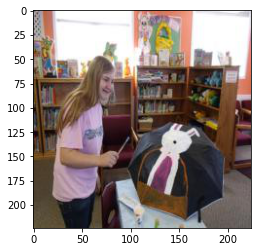

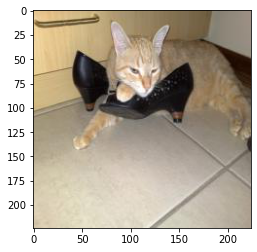

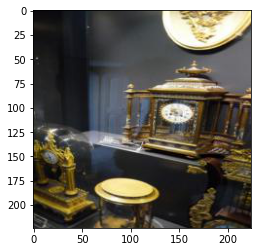

(None, None, None)

In [4]:
show_image(image1), show_image(image2), show_image(205)

## Tags

Each image has associated tags provided by a human.

In [5]:
def get_tags(image_index, train_set=True):
    """Get tags of image with given index.
    
    Parameters
    ----------
    image_index: int
        Numeric index of the image (max 9999 for train, max 1999 for test).
    train_set: bool (default=True)
        Whether to look in the train or in the test set.
        
    Returns
    -------
    tags: list of string
        List of tags associated with each image.
    """
    if train_set:
        dataset = 'train'
    else:
        dataset = 'test'
    f = open(
        os.path.join(f'tags_{dataset}/{image_index}.txt'))
    tags = f.readlines()
    f.close()
    # Some post processing
    tags = [t.strip("\n.") for t in tags]
    return tags

In [6]:
get_tags(207)

['person:person', 'outdoor:bench', 'sports:skateboard', 'vehicle:car']

In [7]:
def get_tags_split(image_index, train_set=True):
    """get tag categories and tagwords of image"""
    tags = get_tags(image_index, train_set)
    tag_categories = []
    tag_words = []
    for tag in tags:
        split_tag = tag.split(":")
        tag_categories.append(split_tag[0])
        tag_words.append(split_tag[1])
    return tag_categories, tag_words

# testing
get_tags_split(207)

(['person', 'outdoor', 'sports', 'vehicle'],
 ['person', 'bench', 'skateboard', 'car'])

In [8]:
def get_all_tag_categories():
    """
    returns list of all possible tag categories (i.e. everything before the : for all tags)"""
    categories=[]
    for idx in range(10000): # training set
        tag_categories, _ = get_tags_split(idx)
        for cat in tag_categories:
            if not cat in categories:
                categories.append(cat)
    for idx in range(2000): # test set
        tag_categories, _ = get_tags_split(idx, train_set=False)
        for cat in tag_categories:
            if not cat in categories:
                categories.append(cat)
    return sorted(categories)

# see categories
all_tag_categories = get_all_tag_categories()
all_tag_categories

['accessory',
 'animal',
 'appliance',
 'electronic',
 'food',
 'furniture',
 'indoor',
 'kitchen',
 'outdoor',
 'person',
 'sports',
 'vehicle']

In [9]:
# trying to see if adding only select tags might help
select_tag_categories = ['furniture','kitchen','person','vehicle'] # based on suggestion by Anna on kaggle

# get all tag words that have 2+ words
def get_tags_multi_word():
    lst=[]
    for i in range(10000):
        cat, words = get_tags_split(i)
        for word in words:
            if " " in word and word not in lst:
                lst.append(word)
    for i in range(2000):
        cat, words = get_tags_split(i, train_set=False)
        for word in words:
            if " " in word and word not in lst:
                lst.append(word)
    return lst

get_tags_multi_word()

['dining table',
 'traffic light',
 'baseball bat',
 'baseball glove',
 'stop sign',
 'wine glass',
 'potted plant',
 'sports ball',
 'fire hydrant',
 'teddy bear',
 'cell phone',
 'tennis racket',
 'parking meter',
 'hot dog',
 'hair drier']

## ResNet Feature Vectors

Each image has 1000 features provided extracted from the penultimate layer of the pretrained ResNet neural network.

Importing word2vec

In [10]:
import gensim
word2vec = gensim.models.KeyedVectors.load_word2vec_format("GoogleNews-vectors-negative300.bin.gz", binary=True)
print("Loaded word vectors successfully!")

Loaded word vectors successfully!


In [11]:
# Example usage of featurizing descriptions
word2vec.get_vector("carrot").shape

(300,)

In [12]:
# def remove_single_occurrence_words(sentence):
#     """Remove words in sentence that occur only once"""
#     words_lst = sentence.split()
#     new_words_lst=[i for i in words_lst if words_lst.count(i)>1]
#     new_sentence = " ".join(new_words_lst)
#     return new_sentence
    

# def add_recurring_words(sentence,n):
#     """For all words that appear more than once, add each n times to the sentence"""
#     recurring_words=remove_single_occurrence_words(sentence)
#     recurring_words_lst = recurring_words.split()
#     # remove duplicates
#     new_lst = []
#     [new_lst.append(x) for x in recurring_words_lst if x not in new_lst]
#     new_sentence = sentence
#     for i in range(n):
#         new_sentence = new_sentence + " " + " ".join(new_lst)
#     return new_sentence
    
def doc_to_vec(sentence, word2vec):
    """Convert text to a 300-dimensional vector
    
    Each word is converted to a vector via the word-to-vec model and the vectors are averaged
    to give the final result.
    
    Parameters
    ----------
    sentence: string
        Text to be converted to a vector.
    word2vec: word2vec model
        Movel to be used for vectorization.
        
    Returns
    -------
    vec: array of shape (300, )
        Vector that represents the average of word2vec-transformed vectors for the given sentence. 
    """
#     word_vecs = [word2vec.get_vector(w.lower()) for w in sentence.split() if w.lower() in word2vec.key_to_index]
    
#     # Return average    
#     return np.stack(word_vecs).mean(0)
    
#     sentence = remove_single_occurrence_words(sentence) 
#     sentence = add_recurring_words(sentence,1)
    word_vecs = [word2vec.get_vector(w.lower()) for w in sentence.split() if w.lower() in word2vec.key_to_index]
    # Return average    
    return np.stack(word_vecs).mean(0)
    

In [13]:


def featurize_tags(image_index, train_set=True, select_tags=False):
    """for image_index, return featurized version of the tag for that image"""
    vector = np.array([])
    image_tag_categories, image_tag_words = get_tags_split(image_index, train_set)
    for tag_category in (all_tag_categories if not select_tags else select_tag_categories):
        if tag_category in image_tag_categories:
            indices = [i for i, x in enumerate(image_tag_categories) if x == tag_category] #indices of tags that match category
#             idx = image_tag_categories.index(tag_category)
            # if image tag word has more than one word, just take the first word out of the phrase
#             word = np.array(image_tag_words)[indices] if " " not in any(letter in word for word in np.array(image_tag_words)[indices]) else for anyimage_tag_words[idx].split(" ")[0]
#             vectorized_word = word2vec.get_vector(word)
            words = np.array(image_tag_words)[indices]
            words = list(words)
            for word in words:
                # use the below two lines to take only first word if the tag has 2+ words, otherwise we're taking avg
                if " " in word:
                    words[words.index(word)]=words[words.index(word)].split(" ")[0] # if word has more than one word, use only first word
            sentence = " ".join(words)
            vectorized_word = doc_to_vec(sentence, word2vec)
        else:
            vectorized_word= np.zeros(300) #no tag for this word
        vector= np.append(vector, vectorized_word)
    return vector
            

# "important" tags according to kaggle discussion post
important_tags=['person:person','furniture:chair','vehicle:car','furniture:dining table','kitchen:bottle','kitchen:cup']

def featurize_tags_2(image_index, train_set=True):
    """
    only featurizes the tags:
    person:person
    furniture:chair
    vehicle:car
    furniture:dining table
    kitchen:bottle
    kitchen:cup
    1 for each if the image has that tag and 0 if not
    """
    vector = np.array([])
    tags = get_tags(image_index,train_set)
    for important_tag in important_tags:
        if important_tag in tags:
            vector=np.append(vector, 1)
        else:
            vector=np.append(vector, 0)
    return vector

def get_feat_matrix(train_set=True):
    """Get feature matrix for given dataset
    
    Parameters
    ----------
    train_set: bool (default=True)
        Whether to look in the train or in the test set.
        
    Returns
    -------
    X: ndarray of shape (n, 1000)
        A matrix containing the ResNet features for the train or test images.
    """
    if train_set:
        dataset = 'train'
    else:
        dataset = 'test'
    feats = pd.read_csv(
        os.path.join(f'features_{dataset}/features_resnet1000_{dataset}.csv'),
        names = ['Image']+["X{}".format(i) for i in range(1000)])
    # Need to sort data
    feats["Image"] = feats["Image"].apply(lambda s: int(s.split("/")[1].split(".jpg")[0]))
    feats.sort_values(by="Image", inplace=True)
    X = feats.values[:, 1:]
    
    
    
    # add tag data
    tag_data_matrix = np.zeros((10000 if train_set else 2000,300*len(all_tag_categories))) # change to all_tag if want to use all tags
#     tag_data_matrix = np.zeros((10000 if train_set else 2000,len(important_tags)))
    for row_num in range(tag_data_matrix.shape[0]):
        featurized_tags = featurize_tags(row_num, train_set, select_tags=False)
#         featurized_tags = featurize_tags_2(row_num, train_set)
        tag_data_matrix[row_num]=featurized_tags
    X = np.concatenate((X,tag_data_matrix),axis=1)
    return X

In [14]:
X_train = get_feat_matrix()
X_train.shape

(10000, 4600)

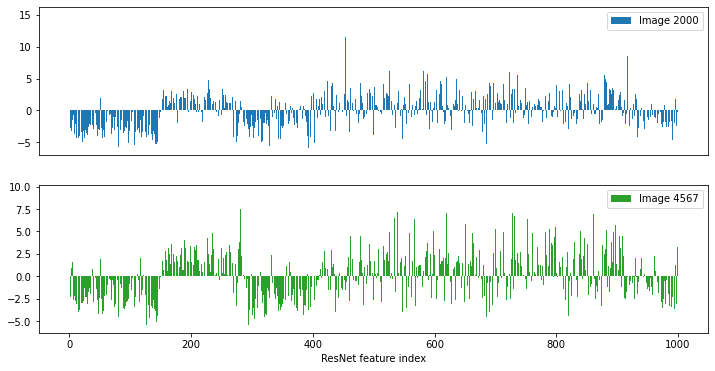

In [15]:
fig, (ax1, ax2) = plt.subplots(2, figsize=(12,6))
ax1.bar(np.arange(1000), X_train[image1,:1000], label=f"Image {image1}")
ax1.set_xticks([])
ax1.legend()
ax2.bar(np.arange(1000), X_train[image2,:1000], label=f"Image {image2}", color='C2')
ax2.legend()
ax2.set_xlabel("ResNet feature index")
plt.show()

## Descriptions 

Each image comes with a series of human given queries (descriptions).

In [16]:
import re
import nltk
nltk.download('stopwords')
nltk.download('averaged_perceptron_tagger')
nltk.download('wordnet')
from nltk.tokenize import WordPunctTokenizer
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer

def postprocess_text(text):
    """
    postprocessing for description obtained by get_description function
    - lowercase everything
    - removed non-words (e.g. numbers, symbols)
    - removed tokens that contain < 2 letters
    - removed tokens that contained only consonants
    - removed stopwords (e.g. prepositions) based on nltk stopwords list
    - lemmatizing
    
    reference: https://towardsdatascience.com/text-processing-in-python-29e86ea4114c
    """
    # Using tokenizer to separate the sentences into a list of single words
    word_punct_token = WordPunctTokenizer().tokenize(text) 
    
    # lowercase, removing non-words, tokens that contain < 2 letters, or contain only consonants
    clean_token=[]
    for token in word_punct_token:
        token = token.lower()
        # remove any value that are not alphabetical
        new_token = re.sub(r'[^a-zA-Z]+', '', token) 
        # remove empty value and single character value
        if new_token != "" and len(new_token) >= 2: 
            vowels=len([v for v in new_token if v in "aeiou"])
            if vowels != 0: # remove line that only contains consonants
                clean_token.append(new_token)
                
    # remove stopwords
    stop_words = stopwords.words('english')     # Get the list of stop words
    # add new stopwords to the list
    stop_words.extend(["could","though","would","also","many",'much','image','images','picture','pictures','really',
                      'background','view'])
    # based off a list from github post https://gist.github.com/sebleier/554280 - complete list of english stopwords
    stop_words.extend(["able", "about", "above", "abst", "ac", "accordance", "according", "accordingly", "across",
                       "act", "actually", "ad", "added", "adj", "ae", "af", "affected", "affecting", "affects", "after",
                       "afterwards", "ag", "again", "against", "ah", "ain", "ain't", "aj", "al", "all", "allow",
                       "allows", "almost", "along", "already", "also", "although", "always", "am", "among",
                       "amongst", "amoungst", "amount", "an", "and", "announce", "another", "any", "anybody",
                       "anyhow", "anymore", "anyone", "anything", "anyway", "anyways", "anywhere", "ao", "ap",
                       "apart", "apparently", "appear", "appreciate", "appropriate", "approximately", "ar",
                       "are", "aren", "arent", "aren't", "arise", "around", "as", "a's", "aside", "ask", 
                       "asking", "associated", "at", "au", "auth", "av", "available", "aw", "away", "awfully",
                       "ax", "ay", "az", "b", "b1", "b2", "b3", "ba", "back", "bc", "bd", "be", "became", 
                       "because", "become", "becomes", "becoming", "been", "before", "beforehand", "begin", 
                       "beginning", "beginnings", "begins", "behind", "being", "believe", "below", "beside", 
                       "besides", "best", "better", "between", "beyond", "bi", "bill", "biol", "bj", "bk", "bl", 
                       "bn", "both", "bottom", "bp", "br", "brief", "briefly", "bs", "bt", "bu", "but", "bx", "by", 
                       "c", "c1", "c2", "c3", "ca", "call", "came", "can", "cannot", "cant", "can't", "cause", 
                       "causes", "cc", "cd", "ce", "certain", "certainly", "cf", "cg", "ch", "changes", "ci", 
                       "cit", "cj", "cl", "clearly", "cm", "c'mon", "cn", "co", "com", "come", "comes", "con", 
                       "concerning", "consequently", "consider", "considering", "contain", "containing", 
                       "contains", "corresponding", "could", "couldn", "couldnt", "couldn't", "course", "cp", 
                       "cq", "cr", "cs", "c's", "ct", "cu", "currently", "cv", "cx", "cy", "cz", "d", "d2", 
                       "da", "date", "dc", "dd", "de", "definitely", "describe", "described", "despite", 
                       "detail", "df", "di", "did", "didn", "didn't", "different", "dj", "dk", "dl", "do", 
                       "does", "doesn", "doesn't", "doing", "don", "done", "don't", "dp", "dr", "ds", "dt", 
                       "du", "due", "during", "dx", "dy", "e", "e2", "e3", "ea", "each", "ec", "ed", "ee", 
                       "ef", "effect", "eg", "ei", "either", "ej", "el", "else", "elsewhere", "em", "en", 
                       "enough", "entirely", "eo", "ep", "eq", "er", "es", "especially", "est", "et", "et-al", 
                       "etc", "eu", "ev", "even", "ever", "every", "everybody", "everyone", "everything", 
                       "everywhere", "ex", "exactly", "example", "except", "ey", "f", "f2", "fa", "far", "fc", 
                       "few", "ff", "fi", "find", "fire", "first", "fix", "fj", "fl", "fn", "fo", "for",
                       "former", "formerly", "forth", "found", "fr", "from", "front", "fs", "ft", "fu",
                       "further", "furthermore", "fy", "g", "ga", "gave", "ge", "get", "gets", "getting",
                       "gi", "gj", "gl", "go", "goes", "going", "gone", "got", "gotten", "gr", 
                       "had", "hadn", "hadn't", "happens", "hardly", "has", "hasn", "hasnt", "hasn't",
                       "have", "haven", "haven't", "having", "he", "hed", "he'd", "he'll", "hence", "her", 
                       "here", "hereafter", "hereby", "herein", "heres", "here's", "hereupon", "hers",
                       "herself", "hes", "he's", "hh", "hi", "hid", "him", "himself", "his", "hither",
                       "hj", "ho", "home", "hopefully", "how", "howbeit", "however", "how's", "hr", "hs",
                       "http", "hu", "hundred", "hy", "id", "i'd", "ie", "if", "i'll", "im", "i'm",
                       "immediate", "immediately", "importance", "important", "in", "inasmuch", "inc",
                       "indeed", "index", "indicate", "indicated", "indicates", "inner", "insofar", "instead",
                       "into", "inward", "is", "isn", "isn't", "it", "itd", "it'd", "it'll", "its", "it's",
                       "itself", "iv", "i've", "just", "k", "ke", "keep", "keeps", "kept", "kg", "kj", "km",
                       "know", "known", "knows", "ko", "l", "l2", "la", "largely", "last", "lately", "later",
                       "latter", "latterly", "lb", "lc", "le", "least", "les", "less", "lest", "let", "lets",
                       "let's", "lf", "like", "liked", "likely", "line", "little", "lj", "ll", "ll", "ln", "lo",
                       "look", "looking", "looks", "los", "lr", "ls", "lt", "ltd", "m", "m2", "ma", "made",
                       "mainly", "make", "makes", "many", "may", "maybe", "me", "mean", "means", "meantime",
                       "meanwhile", "merely", "mg", "might", "mightn", "mightn't", "mill", "million", "mine",
                       "miss", "ml", "mn", "mo", "more", "moreover", "most", "mostly", "move", "mr", "mrs",
                       "ms", "mt", "mu", "much", "mug", "must", "mustn", "mustn't", "my", "myself", "n", "n2",
                       "na", "name", "namely", "nay", "nc", "nd", "ne", "near", "nearly", "necessarily",
                       "necessary", "need", "needn", "needn't", "needs", "neither", "never", "nevertheless",
                       "next", "ng", "ni", "nine", "nj", "nl", "nn", "nobody", "non", "none", "nonetheless",
                       "noone", "nor", "normally", "nos", "not", "noted", "nothing", "novel", "now", "nowhere",
                       "nr", "ns", "nt", "ny", "o", "oa", "ob", "obtain", "obtained", "obviously", "oc", "od",
                       "of", "off", "often", "og", "oh", "oi", "oj", "ok", "okay", "ol", "old", "om", "omitted",
                       "on", "once", "one", "ones", "only", "onto", "oo", "op", "oq", "or", "ord", "os", "ot",
                       "other", "others", "otherwise", "ou", "ought", "our", "ours", "ourselves", "out",
                       "outside", "over", "overall", "ow", "owing", "own", "ox", "oz", "p", "p1", "p2", "p3",
                       "pagecount", "pages", "par", "part", "particular", "particularly", "pas", "pc", "pd",
                       "pe", "per", "perhaps", "pf", "ph", "pi", "pj", "pk", "pl", "placed", "please", "plus",
                       "pm", "pn", "po", "poorly", "possible", "possibly", "potentially", "pp", "pq", "pr",
                       "predominantly", "present", "presumably", "previously", "primarily", "probably", "promptly",
                       "proud", "provides", "ps", "pt", "pu", "put", "py", "q", "qj", "qu", "que", "quickly",
                       "quite", "qv", "r", "r2", "ra", "ran", "rather", "rc", "rd", "re", "readily", "really",
                       "reasonably", "recent", "recently", "ref", "refs", "regarding", "regardless", "regards",
                       "related", "relatively", "research", "research-articl", "respectively", "resulted",
                       "resulting", "results", "rf", "rh", "ri", "right", "rj", "rl", "rm", "rn", "ro", "rq",
                       "rr", "rs", "rt", "ru", "rv", "ry", "s", "s2", "sa", "said", "same", "saw", "say",
                       "saying", "says", "sc", "sd", "se", "sec", "second", "secondly", "see", "seeing",
                       "seem", "seemed", "seeming", "seems", "seen", "self", "selves", "sensible",
                       "sent", "serious", "seriously", "seven", "several", "sf", "shall", "shan", "shan't",
                       "she", "shed", "she'd", "she'll", "shes", "she's", "should", "shouldn", "shouldn't",
                       "should've", "show", "showed", "shown", "showns", "shows", "si", "side", "significant",
                       "significantly", "similar", "similarly", "since", "sincere", "six", "sixty", "sj", "sl",
                       "slightly", "sm", "sn", "so", "some", "somebody", "somehow", "someone", "somethan",
                       "something", "sometime", "sometimes", "somewhat", "somewhere", "soon", "sorry", "sp",
                       "specifically", "specified", "specify", "specifying", "sq", "sr", "ss", "st", "still", 
                       "strongly", "sub", "substantially", "successfully", "such", "sufficiently", "suggest", 
                       "sup", "sure", "sy", "system", "sz", "t", "t1", "t2", "t3", "take", "taken", "taking", 
                       "tb", "tc", "td", "te", "ten", "tends", "tf", "th", "than", "thanx", "that", "that'll",
                       "thats", "that's", "that've", "the", "their", "theirs", "them", "themselves", "then",
                       "thence", "there", "thereafter", "thereby", "thered", "therefore", "therein", "there'll",
                       "thereof", "therere", "theres", "there's", "thereto", "thereupon", "there've", "these",
                       "they", "theyd", "they'd", "they'll", "theyre", "they're", "they've", "thickv", "thin",
                       "think", "third", "this", "thorough", "thoroughly", "those", "thou", "though", "thoughh",
                       "thousand", "throug", "through", "throughout", "thru", "thus", "ti", "til", "tj", 
                       "tl", "tm", "tn", "to", "too", "took", "toward", "towards", "tp", "tq", "tr", "tried", 
                       "tries", "truly", "trying", "ts", "t's", "tt", "tx", "u", "u201d", "ue", "ui", "uj",
                       "uk", "um", "un", "under", "unfortunately", "unless", "unlike", "unlikely", "until",
                       "unto", "uo", "up", "upon", "ups", "ur", "us", "use", "used", "useful", "usefully",
                       "usefulness", "uses", "using", "usually", "ut", "v", "va", "value", "various", "vd",
                       "ve", "ve", "very", "via", "viz", "vj", "vo", "vol", "vols", "volumtype",
                       "vq", "vs", "vt", "vu", "w", "wa", "want", "wants", "was", "wasn", "wasnt", "wasn't",
                       "way", "we", "wed", "we'd", "welcome", "well", "we'll", "well-b", "went", "were",
                       "we're", "weren", "werent", "weren't", "we've", "what", "whatever", "what'll", "whats",
                       "what's", "when", "whence", "whenever", "when's", "where", "whereafter", "whereas",
                       "whereby", "wherein", "wheres", "where's", "whereupon", "wherever", "whether", "which",
                       "while", "whim", "whither", "who", "whod", "whoever", "whole", "who'll", "whom", "whomever",
                       "whos", "who's", "whose", "why", "why's", "wi", "widely", "will", "willing", 
                       "with", "within", "without", "wo", "won", "wonder", "wont", "won't", "words", "would",
                       "wouldn", "wouldnt", "wouldn't", "www", "x", "x1", "x2", "x3", "xf", "xi", "xj",
                       "xk", "xl", "xn", "xo", "xs", "xt", "xv", "xx", "y", "y2", "yes", "yet", "yj", "yl",
                       "you", "youd", "you'd", "you'll", "your", "youre", "you're", "yours", "yourself",
                       "yourselves", "you've", "yr", "ys", "yt", "z", "zero", "zi", "zz"])
    stop_words=sorted(set(stop_words)) # remove duplicates
    # Remove the stopwords from the list of tokens
    tokens = [x for x in clean_token if x not in stop_words]
    
    # part of speech tagging
    data_tagset = nltk.pos_tag(tokens)
    df_tagset = pd.DataFrame(data_tagset, columns=['Word', 'Tag']) # put (word, tag) tuples into df
    
    # lemmatizing
    lemmatizer = WordNetLemmatizer() # Create lemmatizer object 
    # Lemmatize each word and display the output
    lemmatize_text = []
    for word in tokens:
        # lemmatize based on all POS to improve accuracy of lemmatizer
        output = [word, lemmatizer.lemmatize(word, pos='n'),
                  lemmatizer.lemmatize(word, pos='a'),
                  lemmatizer.lemmatize(word, pos='v')]
        lemmatize_text.append(output)
    # create DataFrame using original words and their lemma words
    df = pd.DataFrame(lemmatize_text, columns =['Word', 'Lemmatized Noun', 'Lemmatized Adjective', 'Lemmatized Verb']) 
    df['Tag'] = df_tagset['Tag']
    
    # assign the correct lemmatized word to the original word according to their POS Tag
    # replace with single character for simplifying
    df = df.replace(['NN','NNS','NNP','NNPS'],'n')
    df = df.replace(['JJ','JJR','JJS'],'a')
    df = df.replace(['VBG','VBP','VB','VBD','VBN','VBZ'],'v')
    
    # take the correct lemmatized word based on word's tagged POS
    df_lemmatized = df.copy()
    df_lemmatized['Tempt Lemmatized Word']=df_lemmatized['Lemmatized Noun'] + ' | ' + df_lemmatized['Lemmatized Adjective']+ ' | ' + df_lemmatized['Lemmatized Verb']
    lemma_word = df_lemmatized['Tempt Lemmatized Word']
    tag = df_lemmatized['Tag']
    i = 0
    new_word = []
    while i<len(tag):
        words = lemma_word[i].split('|')
        if tag[i] == 'n':
            word = words[0]
        elif tag[i] == 'a':
            word = words[1]
        elif tag[i] == 'v':
            word = words[2]
        new_word.append(word)
        i += 1
    df_lemmatized['Lemmatized Word']=new_word
    
    # obtain cleaned tokens as list
    lemma_word = [str(x) for x in df_lemmatized['Lemmatized Word']]
    lemma_word = [re.sub(' +', ' ', x) for x in lemma_word]
    lemma_word = [x.strip() for x in lemma_word]
#     lemma_word = list(set(lemma_word)) # remove duplicates
    
    # convert list to str
    text = " ".join(lemma_word)
    
    return text

[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/ibt2user/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /Users/ibt2user/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!
[nltk_data] Downloading package wordnet to
[nltk_data]     /Users/ibt2user/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


In [17]:
stopwords.words('english')

['i',
 'me',
 'my',
 'myself',
 'we',
 'our',
 'ours',
 'ourselves',
 'you',
 "you're",
 "you've",
 "you'll",
 "you'd",
 'your',
 'yours',
 'yourself',
 'yourselves',
 'he',
 'him',
 'his',
 'himself',
 'she',
 "she's",
 'her',
 'hers',
 'herself',
 'it',
 "it's",
 'its',
 'itself',
 'they',
 'them',
 'their',
 'theirs',
 'themselves',
 'what',
 'which',
 'who',
 'whom',
 'this',
 'that',
 "that'll",
 'these',
 'those',
 'am',
 'is',
 'are',
 'was',
 'were',
 'be',
 'been',
 'being',
 'have',
 'has',
 'had',
 'having',
 'do',
 'does',
 'did',
 'doing',
 'a',
 'an',
 'the',
 'and',
 'but',
 'if',
 'or',
 'because',
 'as',
 'until',
 'while',
 'of',
 'at',
 'by',
 'for',
 'with',
 'about',
 'against',
 'between',
 'into',
 'through',
 'during',
 'before',
 'after',
 'above',
 'below',
 'to',
 'from',
 'up',
 'down',
 'in',
 'out',
 'on',
 'off',
 'over',
 'under',
 'again',
 'further',
 'then',
 'once',
 'here',
 'there',
 'when',
 'where',
 'why',
 'how',
 'all',
 'any',
 'both',
 'each

In [18]:
def get_description(image_index, train_set=True):
    """Get description of image with given index.
    
    Parameters
    ----------
    image_index: int
        Numeric index of the image (max 9999 for train, max 1999 for test).
    train_set: bool (default=True)
        Whether to look in the train or in the test set.
        
    Returns
    -------
    description: string
        The description of the image as a paragraph of text with punctuation removed.
    """
    if train_set:
        dataset = 'train'
    else:
        dataset = 'test'
    f = open(
        os.path.join(f'descriptions_{dataset}/{image_index}.txt'))
    desc = f.read()
    f.close()
    # Some post-processing 
    desc = postprocess_text(desc)
    
    return desc

In [19]:
get_description(211)

'provide description male tennis player middle game tennis player run hit ball person play tennis stadium tennis player run tennis racket hand'

**The Task:** Map descriptions to images (featurized by tags and ResNet features). 

# Baseline approach

This baseline approach combines a language model with the ResNet vision model to map descriptions to images via regression. These are the steps:

1. Featurize the descriptions using the pre-trained [word2vec](https://www.tensorflow.org/tutorials/representation/word2vec) language model. This will serve as your model features $\textbf{X}$. 

2. Subsample the ResNet feature vectors down to 100 features. This will serve as your model target $\textbf{Y}$. 

3. Train a model (i.e. Ridge Regression) that maps $\textbf{X}\rightarrow \textbf{Y}$, i.e. the extracted description features to the subsampled ResNet  features.

4. Use the trained model to find the predicted subsampled ResNet vector. Then find the 20 images in the test set for which the subsampled ResNet vectors are closest to the predicted vector in Euclidian distance. 

In [20]:
# uncomment this when you run for the first time

# # Some preliminaries
# # Comment this out after you run it for the first time

# # Install packages
# !pip install gensim
# import gensim

# # Download files
# import urllib.request
# import os
# # You can change the path to the downloaded file here
# if not os.path.exists("GoogleNews-vectors-negative300.bin.gz"):
#     urllib.request.urlretrieve("https://s3.amazonaws.com/dl4j-distribution/GoogleNews-vectors-negative300.bin.gz", filename="GoogleNews-vectors-negative300.bin.gz")

## Featurize descriptions

Recall, these will become your features $\textbf{X}$.

In order to featurize the descriptions, we use <a href="https://www.tensorflow.org/tutorials/representation/word2vec">word2vec</a>, which provides a pre-trained 300-dimensional vector representation of most words in the English language. 

We downloaded the word vectors in a file called `GoogleNews-vectors-negative300.bin.gz` from the above link and we will use the <a href="https://radimrehurek.com/gensim/">gensim</a> library in order to access the vectors easily in our code. The feature vector for a given description was then formed by averaging the 300-dimensional word2vec vectors of all the words in the description.

In [21]:
train_desc = [get_description(i) for i in range(10000)]
test_desc = [get_description(i, train_set=False) for i in range(2000)]

In [22]:
# Example
doc_to_vec("I love this class!", word2vec)[:10]
doc_to_vec("I love this class!", word2vec).shape

(300,)

In [23]:
X = np.array([doc_to_vec(s, word2vec) for s in train_desc])
X_test = np.array([doc_to_vec(s, word2vec) for s in test_desc])

In [24]:
print("Shape of X:", X.shape)
print("Shape of X_test:", X_test.shape)
print("Done building features!")

Shape of X: (10000, 300)
Shape of X_test: (2000, 300)
Done building features!


## Featurizing descriptions using gensim doc2vec
This didn't really help much unfortunately :(

In [25]:
# def get_all_descriptions(train_set=True,get_all=False):
#     """returns all descriptions of training or test set in order
#     if get_all=True, returns all descriptions in training and test set"""
#     descriptions=[]
#     if get_all:
#         for i in range(10000):
#             descriptions.append(get_description(i))
#         for i in range(2000):
#             descriptions.append(get_description(i, train_set=False))
#     elif train_set:
#         for i in range(10000):
#             descriptions.append(get_description(i))
#     else:
#         for i in range(2000):
#             descriptions.append(get_description(i, train_set=False))
#     return descriptions



In [26]:
# # getting data to train doc2vec

# # list of all descriptions as data
# data = get_all_descriptions(get_all=True)
# print('Got descriptions\n')

In [27]:
# from gensim.models.doc2vec import Doc2Vec, TaggedDocument
# from nltk.tokenize import word_tokenize
# nltk.download('punkt')

# tagged_data = [TaggedDocument(words=word_tokenize(_d.lower()), tags=[str(i)]) for i, _d in enumerate(data)]
# print('Got tagged data\n')

In [28]:
# def train_doc2vec():
#     """training gensim doc2vec model"""

#     # training from: https://medium.com/@mishra.thedeepak/doc2vec-simple-implementation-example-df2afbbfbad5
#     max_epochs = 100
#     vec_size = 300
#     alpha = 0.025

#     model = Doc2Vec(vector_size=vec_size,
#                 alpha=alpha, 
#                 min_alpha=0.00025,
#                 min_count=0,
#                 dm =0) #dm=0 means dist bag of words
  
#     model.build_vocab(tagged_data)

#     for epoch in range(max_epochs):
#         print('iteration {0}'.format(epoch))
#         model.train(tagged_data,
#                     total_examples=model.corpus_count,
#                     epochs=model.epochs)
#         # decrease the learning rate
#         model.alpha -= 0.0002
#         # fix the learning rate, no decay
#         model.min_alpha = model.alpha
#         print('Epoch:', epoch)

#     model.save("d2v.model")
#     print("Model Saved")
    
# #start training    
# train_doc2vec()

In [29]:
# d2v_model= Doc2Vec.load("d2v.model")
# X = np.array([d2v_model.infer_vector(word_tokenize(s)) for s in train_desc])
# X_test = np.array([d2v_model.infer_vector(word_tokenize(s)) for s in test_desc])

In [30]:
# print("Shape of X:", X.shape)
# print("Shape of X_test:", X_test.shape)
# print("Done building features!")

## Subsample ResNet features

In order to form the target image vectors for each image we took the 1,000 ResNet and performed a random projection of these features down to 100 dimensions.

In [31]:
# Use PCA to reduce dimensions
from sklearn.decomposition import PCA
n_components = 1500
pca = PCA(n_components = n_components)
pca.fit(get_feat_matrix())
Y = pca.transform(get_feat_matrix())
Y_test = pca.transform(get_feat_matrix(train_set=False))

In [32]:
# # Undo PCA
# Y = get_feat_matrix()
# Y_test = get_feat_matrix(train_set=False)

In [33]:
print("Shape of Y:", Y.shape)
print("Shape of Y_test:", Y_test.shape)
print("Done building features!")

Shape of Y: (10000, 1500)
Shape of Y_test: (2000, 1500)
Done building features!


## Train and Test

We train a regularized linear regression model that mapping a 300-dimensional description vector to the 100-dimensional image vector. We used Ridge with cross-validation to select the best regularization coefficient.

Our approach was validated on a held-out development set (randomly selected 20% subset of the training set) so **MAP@20** could be estimated before submitting to Kaggle. However the final model used to generate test predictions for submission was trained on the entire training set.

In [34]:
# Split training data for CV
from sklearn.model_selection import train_test_split
# X_train, X_val, Y_train, Y_val = train_test_split(X, Y, test_size=2000, random_state=12345)
# X_train, X_val, Y_train, Y_val = train_test_split(X, Y, test_size=2000, random_state=2445)
X_train, X_val, Y_train, Y_val = train_test_split(X, Y, test_size=2000, random_state=1213)
# X_train, X_val, Y_train, Y_val = train_test_split(X, Y, test_size=2000)

In [35]:
from sklearn.preprocessing import MinMaxScaler


scaler_x = MinMaxScaler()
scaler_y = MinMaxScaler()
scaler_x.fit(X)
xtrain_scale=scaler_x.transform(X_train)
xval_scale=scaler_x.transform(X_val)
scaler_y.fit(Y)
ytrain_scale=scaler_y.transform(Y_train)


In [36]:
import tensorflow as tf
import keras

In [37]:
from keras.models import Sequential
from keras.layers import Dense

In [56]:
model = Sequential()
n_dim_x = X.shape[1]
n_dim_y = Y.shape[1]
model.add(Dense(n_dim_x, input_dim=n_dim_x, kernel_initializer='uniform'))
model.add(Dense(max(n_dim_x,n_dim_y)+10, activation='relu', kernel_initializer='uniform'))
model.add(Dense(n_dim_y, activation='sigmoid', kernel_initializer='uniform'))
model.summary()

model.compile(loss='mse', optimizer='adam', metrics=['mse'])
n_epochs = 100
batch_size = 120
history=model.fit(xtrain_scale, ytrain_scale, epochs=n_epochs, batch_size=batch_size, verbose=1, validation_data=(X_val,Y_val))


Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_6 (Dense)             (None, 300)               90300     
                                                                 
 dense_7 (Dense)             (None, 1510)              454510    
                                                                 
 dense_8 (Dense)             (None, 1500)              2266500   
                                                                 
Total params: 2,811,310
Trainable params: 2,811,310
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100
67/67 [==============================] - 2s 19ms/step - loss: 0.0124 - mse: 0.0124 - val_loss: 3.0219 - val_mse: 3.0219
Epoch 2/100
67/67 [==============================] - 1s 17ms/step - loss: 0.0117 - mse: 0.0117 - val_loss: 3.0165 - val_mse: 3.0165
Epoch 3/100
67/67 [=========================

67/67 [==============================] - 1s 16ms/step - loss: 0.0087 - mse: 0.0087 - val_loss: 2.9974 - val_mse: 2.9974
Epoch 57/100
67/67 [==============================] - 1s 16ms/step - loss: 0.0087 - mse: 0.0087 - val_loss: 2.9971 - val_mse: 2.9971
Epoch 58/100
67/67 [==============================] - 1s 16ms/step - loss: 0.0087 - mse: 0.0087 - val_loss: 2.9972 - val_mse: 2.9972
Epoch 59/100
67/67 [==============================] - 1s 16ms/step - loss: 0.0086 - mse: 0.0086 - val_loss: 2.9972 - val_mse: 2.9972
Epoch 60/100
67/67 [==============================] - 1s 15ms/step - loss: 0.0086 - mse: 0.0086 - val_loss: 2.9973 - val_mse: 2.9973
Epoch 61/100
67/67 [==============================] - 1s 16ms/step - loss: 0.0086 - mse: 0.0086 - val_loss: 2.9974 - val_mse: 2.9974
Epoch 62/100
67/67 [==============================] - 1s 16ms/step - loss: 0.0086 - mse: 0.0086 - val_loss: 2.9977 - val_mse: 2.9977
Epoch 63/100
67/67 [==============================] - 1s 16ms/step - loss: 0.0085 

dict_keys(['loss', 'mse', 'val_loss', 'val_mse'])


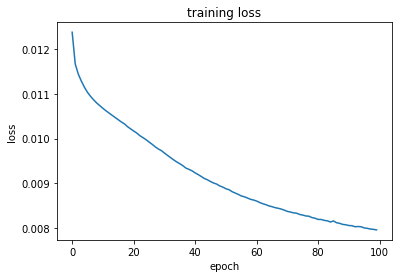

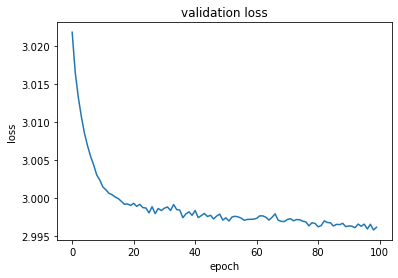

In [57]:
print(history.history.keys())
# "Loss"
plt.figure(0)
plt.plot(history.history['loss'])
plt.title('training loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.figure(1)
plt.plot(history.history['val_loss'])
plt.title('validation loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.show()

In [58]:
# Testing our model

# Map@20
def map_at_20(y_true, y_top_20):
    """Calculate the mean average precision at 20
    
    Parameters
    ----------
    y_true: list of object
        List of the true ID of the image.
        
    y_top_20: ndarray of shape (n, 20)
        List of top 20 IDs predicted for each image.
        
    Returns
    -------
    mean_score: float
        MAP@20 score.
    """
    y_true = np.array(y_true)
    y_top_20 = np.array(y_top_20)
    scores = []
    for i, y_true_i in enumerate(y_true):
        if y_true_i in y_top_20[i]:
            scores.append(1/(np.where(y_top_20[i]==y_true_i)[0][0]+1))
        else:
            scores.append(0)
    return np.mean(scores)
            
# Example
y_true = [1, 2]
y_top_20 = [
    [10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9],
    [20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39]
    ]
map_at_20(y_true, y_top_20)

0.041666666666666664

In [59]:
# predicting with neural network

from sklearn.neighbors import DistanceMetric
from sklearn.metrics.pairwise import cosine_distances
# dist = DistanceMetric.get_metric('euclidean')
# dist = DistanceMetric.get_metric('minkowski')

predictions = model.predict(xval_scale)
predictions = scaler_y.inverse_transform(predictions)

Y_val_pred = predictions
# pw_dist = dist.pairwise(Y_val_pred, Y_val
pw_dist = cosine_distances(Y_val_pred, Y_val) 

print("Pairwise distances shape:", pw_dist.shape)
Y_val_top_20 = [np.argsort(pw_dist[i])[:20] for i in range(len(Y_val_pred))]
Y_val_true = np.arange(2000)

Pairwise distances shape: (2000, 2000)


In [60]:
val_score = map_at_20(Y_val_true, Y_val_top_20)
val_list_pos = [np.where(np.argsort(pw_dist[i])==i)[0][0] for i in range(len(Y_val_pred))]
print("Validation MAP@20:", val_score)
print("Mean index of true image:", np.mean(val_list_pos))
print("Median index of true image:", np.median(val_list_pos))

Validation MAP@20: 0.23331303883380122
Mean index of true image: 47.255
Median index of true image: 11.0


### Submit

We retrain the regression model on the entire dataset and generate test predictions for the Kaggle submission.

In [64]:
def get_Kaggle_submission(y_top_20):
    """Get data in Kaggle submission format
    
    Parameters
    ----------
    y_top_20: ndarray of shape (n, 20)
        A list of top 20 IDs lists that match each of the n descriptions. 
        
    Returns
    -------
    df: pandas.DataFrame
        Dataframe with columns and values that map correctly to Kaggle's expected submission format.
    """
    d = {
        "Description_ID": [f"{i}.txt" for i in range(len(y_top_20))],
        "Top_20_Image_IDs": [" ".join(
            [f"{j}.jpg" for j in y_top_20[i]]
        ) for i in range(len(y_top_20))]
    }
    return pd.DataFrame(d)

# Retrain on all data

# neural network
x_scale=scaler_x.transform(X)
y_scale=scaler_y.transform(Y)
history=model.fit(x_scale, y_scale, epochs=n_epochs, batch_size=batch_size, verbose=1)
xtest_scale = scaler_x.transform(X_test)
Y_test_pred = model.predict(xtest_scale)
Y_test_pred = scaler_y.inverse_transform(Y_test_pred)
pw_dist = cosine_distances(Y_test_pred, Y_test)
Y_test_top_20 = [np.argsort(pw_dist[i])[:20] for i in range(len(Y_test_pred))]
df_submit = get_Kaggle_submission(Y_test_top_20)


Epoch 1/100
84/84 [==============================] - 2s 16ms/step - loss: 0.0079 - mse: 0.0079
Epoch 2/100
84/84 [==============================] - 1s 15ms/step - loss: 0.0080 - mse: 0.0080
Epoch 3/100
84/84 [==============================] - 1s 15ms/step - loss: 0.0079 - mse: 0.0079
Epoch 4/100
84/84 [==============================] - 2s 20ms/step - loss: 0.0079 - mse: 0.0079
Epoch 5/100
84/84 [==============================] - 1s 16ms/step - loss: 0.0079 - mse: 0.0079
Epoch 6/100
84/84 [==============================] - 1s 15ms/step - loss: 0.0079 - mse: 0.0079
Epoch 7/100
84/84 [==============================] - 1s 16ms/step - loss: 0.0079 - mse: 0.0079
Epoch 8/100
84/84 [==============================] - 1s 14ms/step - loss: 0.0079 - mse: 0.0079
Epoch 9/100
84/84 [==============================] - 1s 15ms/step - loss: 0.0079 - mse: 0.0079
Epoch 10/100
84/84 [==============================] - 1s 14ms/step - loss: 0.0079 - mse: 0.0079
Epoch 11/100
84/84 [=============================

84/84 [==============================] - 1s 15ms/step - loss: 0.0077 - mse: 0.0077
Epoch 87/100
84/84 [==============================] - 1s 14ms/step - loss: 0.0077 - mse: 0.0077
Epoch 88/100
84/84 [==============================] - 1s 15ms/step - loss: 0.0077 - mse: 0.0077
Epoch 89/100
84/84 [==============================] - 1s 16ms/step - loss: 0.0077 - mse: 0.0077
Epoch 90/100
84/84 [==============================] - 1s 17ms/step - loss: 0.0077 - mse: 0.0077
Epoch 91/100
84/84 [==============================] - 2s 19ms/step - loss: 0.0077 - mse: 0.0077
Epoch 92/100
84/84 [==============================] - 2s 22ms/step - loss: 0.0077 - mse: 0.0077
Epoch 93/100
84/84 [==============================] - 1s 17ms/step - loss: 0.0077 - mse: 0.0077
Epoch 94/100
84/84 [==============================] - 2s 19ms/step - loss: 0.0077 - mse: 0.0077
Epoch 95/100
84/84 [==============================] - 2s 18ms/step - loss: 0.0077 - mse: 0.0077
Epoch 96/100
84/84 [==============================] -

In [65]:
submit_sample = df_submit[10:20]

left turn sign hang wooden pole sign road vehicle park street busy city street green traffic light sit park lot white building turn sign turn upside pole



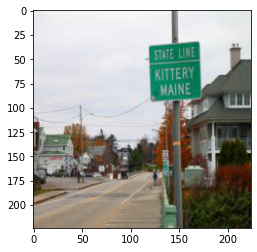

696.jpg


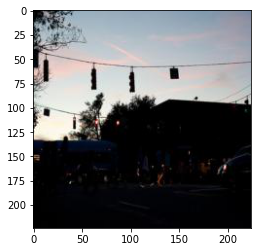

1183.jpg


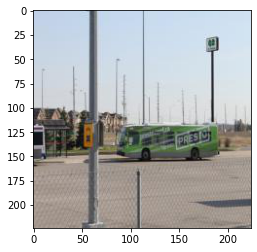

579.jpg


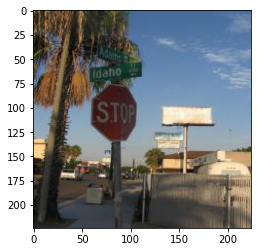

904.jpg


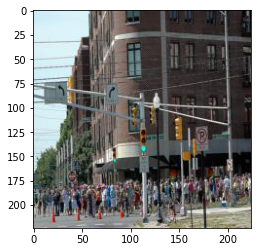

600.jpg


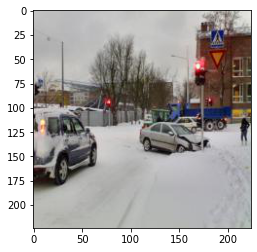

539.jpg


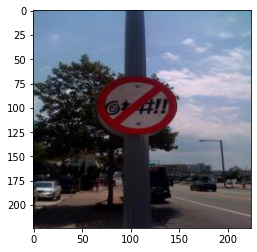

260.jpg


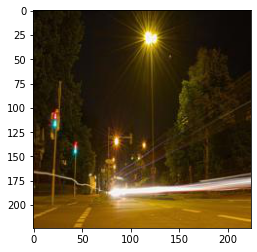

445.jpg


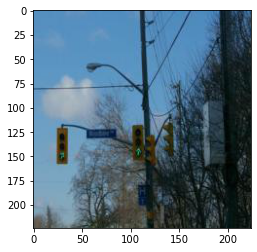

1840.jpg


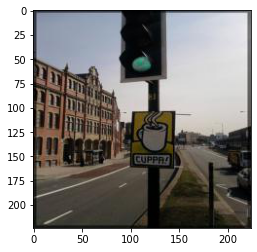

634.jpg


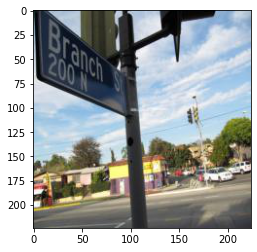

1471.jpg


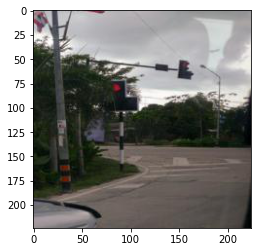

159.jpg


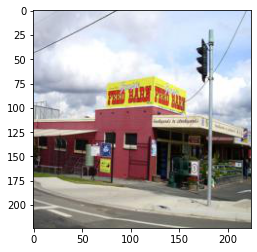

323.jpg


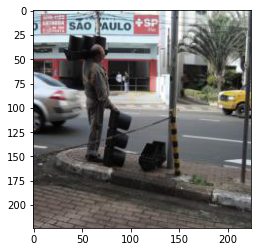

322.jpg


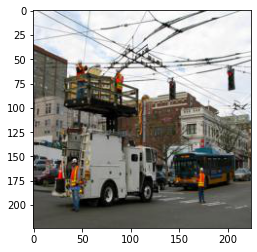

1896.jpg


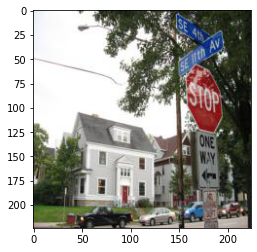

1482.jpg


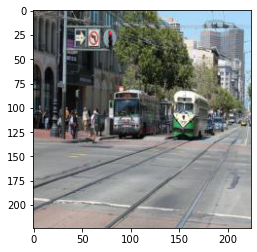

873.jpg


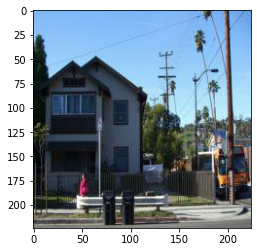

496.jpg


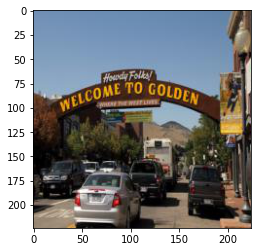

979.jpg


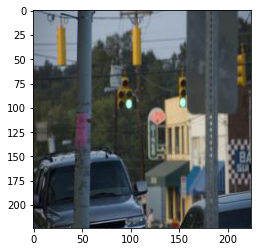

511.jpg
person rid skate board ata skate park bright light showcasing skateboarder flip ramp man rid pool skateboard boy perform skateboard trick skate bowl night person skateboard trick air



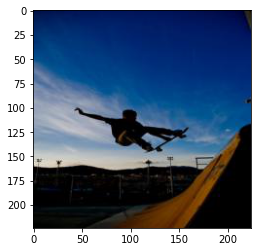

771.jpg


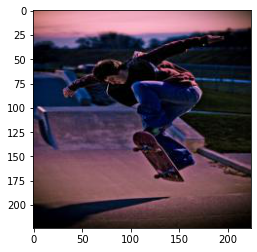

814.jpg


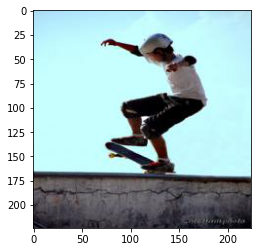

51.jpg


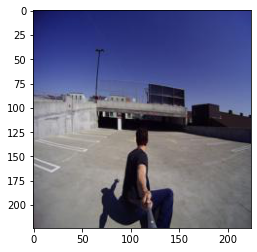

1429.jpg


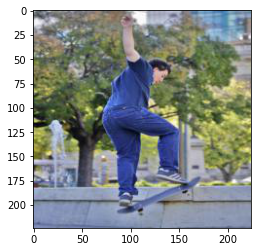

846.jpg


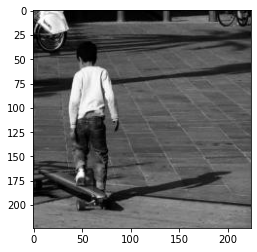

82.jpg


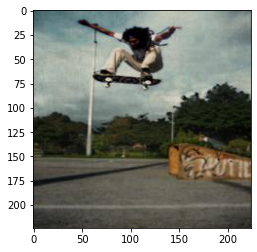

1693.jpg


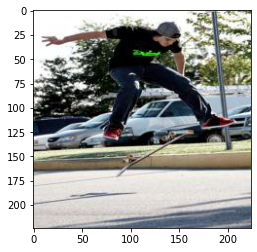

1943.jpg


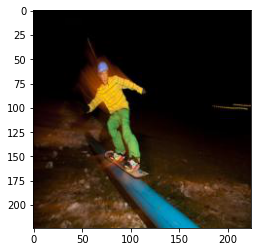

379.jpg


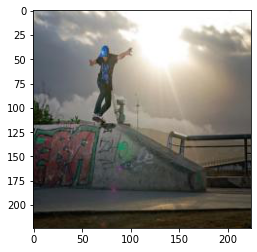

1335.jpg


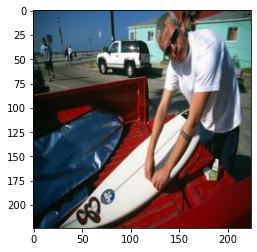

845.jpg


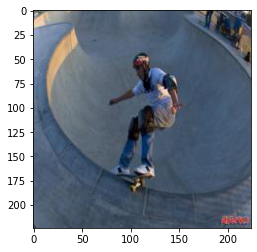

630.jpg


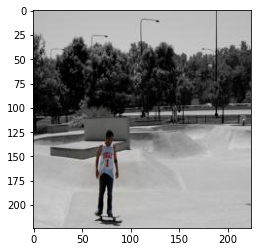

1118.jpg


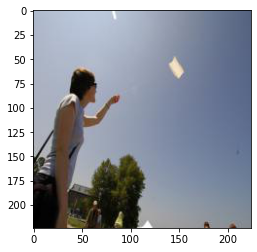

1088.jpg


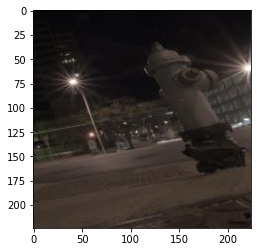

372.jpg


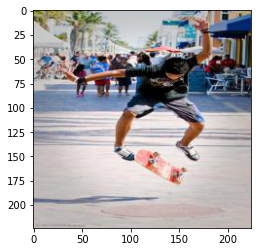

829.jpg


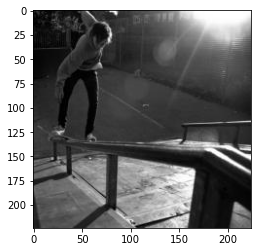

526.jpg


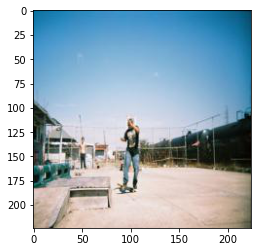

1594.jpg


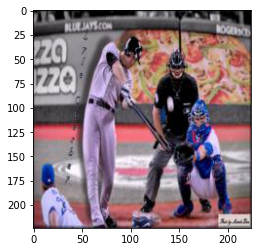

1206.jpg


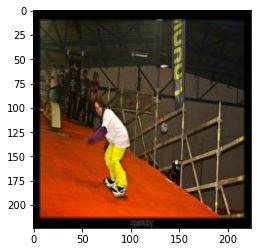

1254.jpg
white compact car park sandy dirt road car drive drive white flat thing man sport utility vehicle surf board roof man stand open door car desert road man car desert



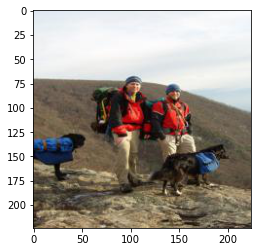

516.jpg


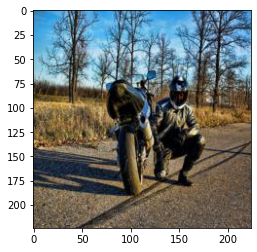

157.jpg


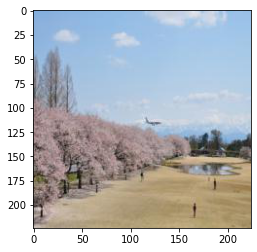

805.jpg


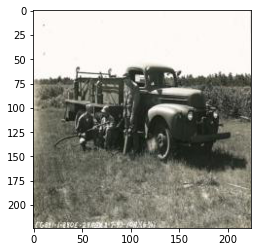

1918.jpg


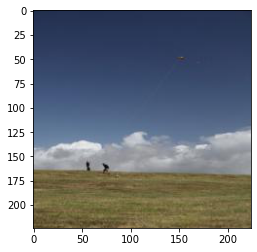

1517.jpg


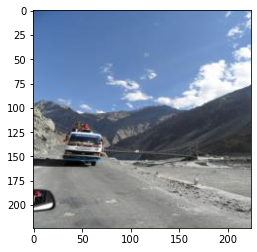

221.jpg


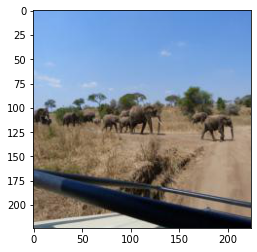

1002.jpg


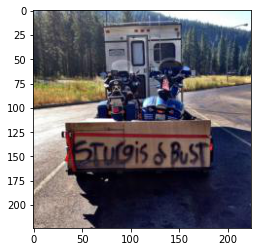

113.jpg


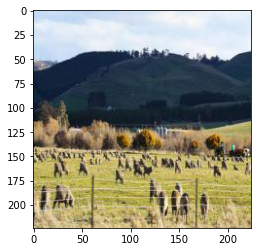

857.jpg


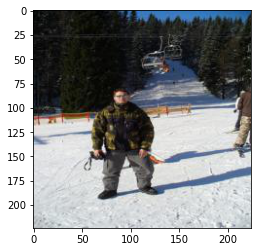

1933.jpg


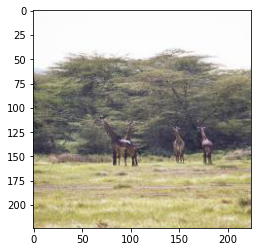

384.jpg


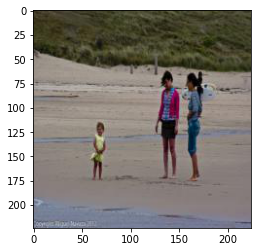

1765.jpg


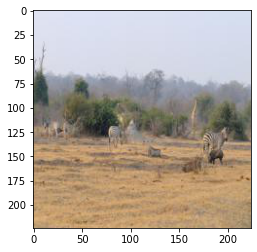

1223.jpg


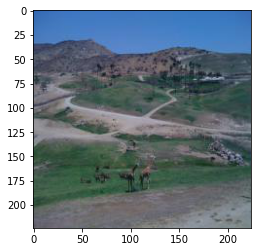

1680.jpg


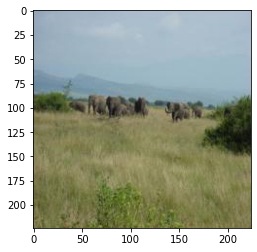

807.jpg


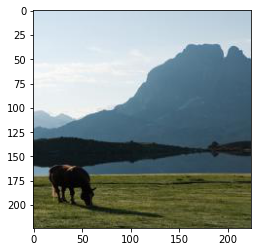

417.jpg


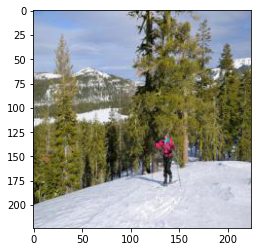

555.jpg


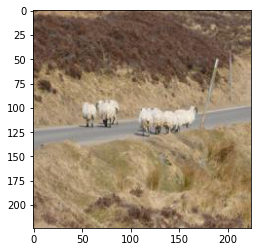

798.jpg


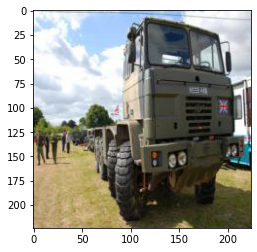

1261.jpg


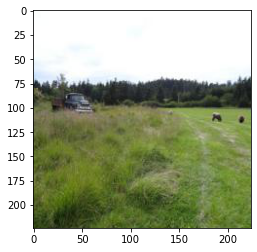

1905.jpg
pose people pose hold ski ski skier middle snowstorm snowstorm people ski stand stand people snow hold wear skis skis skier pose



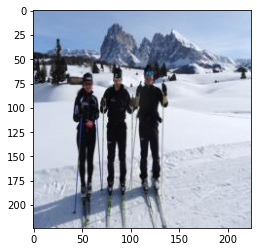

414.jpg


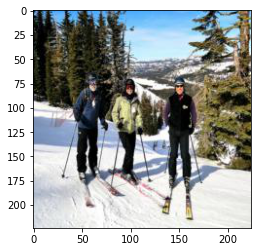

217.jpg


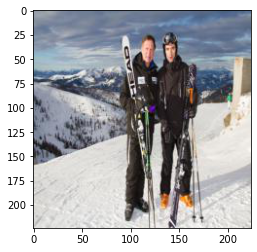

1655.jpg


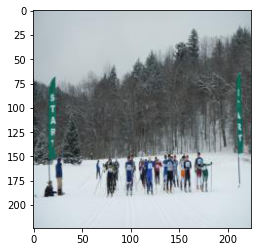

1265.jpg


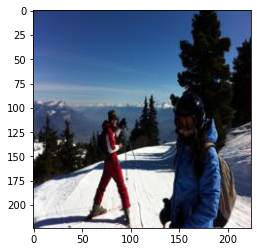

623.jpg


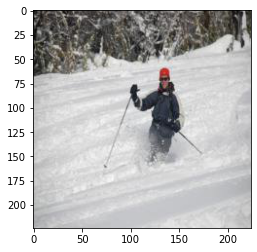

897.jpg


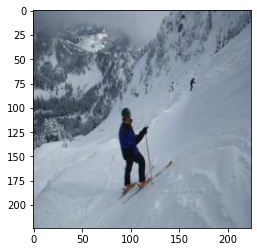

718.jpg


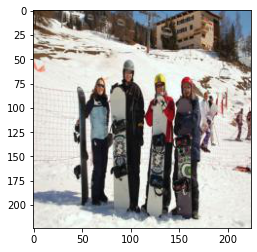

899.jpg


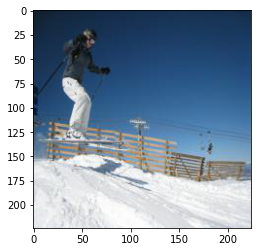

429.jpg


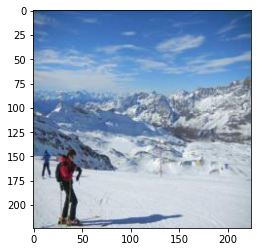

1377.jpg


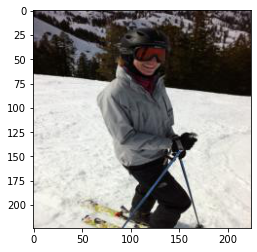

535.jpg


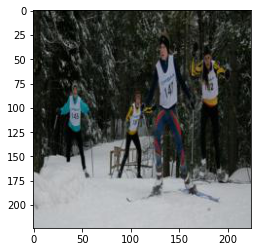

1289.jpg


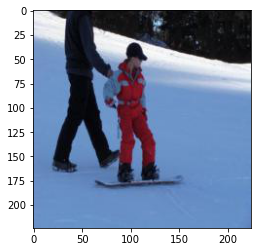

262.jpg


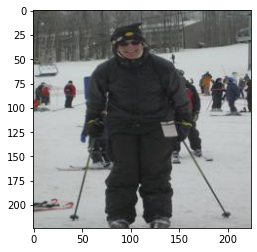

1758.jpg


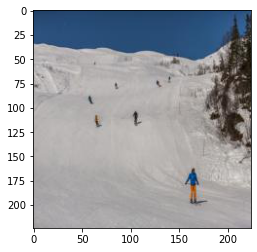

489.jpg


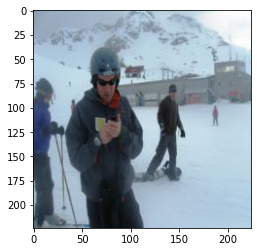

1311.jpg


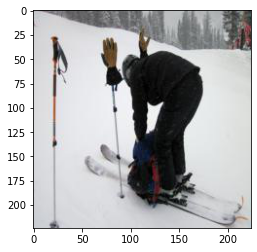

583.jpg


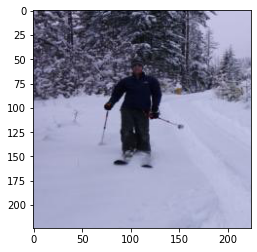

910.jpg


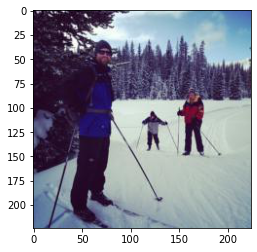

1096.jpg


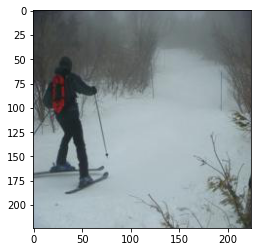

1940.jpg
skier stand pose pose ski group people rid skis snowy surface group people stand ski slope tree tree men walk snow ski ski people stand snow wear snow ski



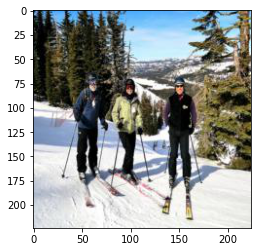

217.jpg


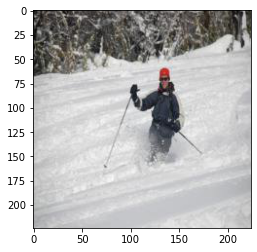

897.jpg


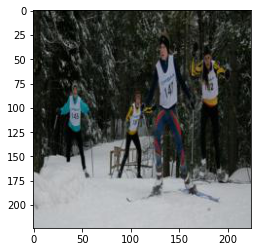

1289.jpg


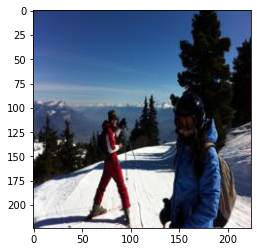

623.jpg


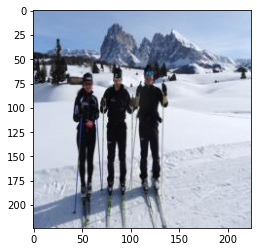

414.jpg


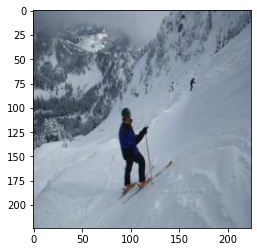

718.jpg


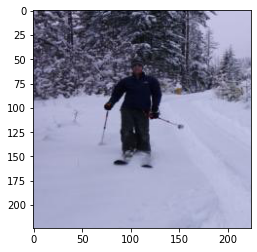

910.jpg


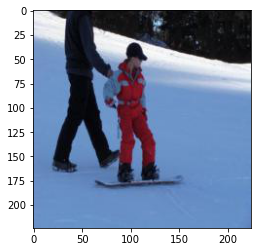

262.jpg


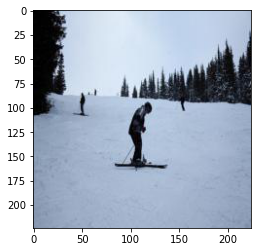

655.jpg


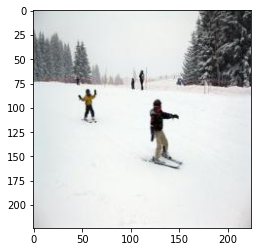

1151.jpg


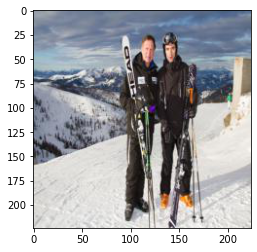

1655.jpg


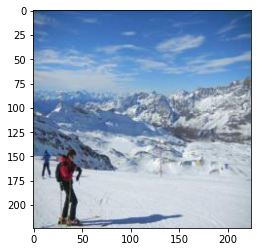

1377.jpg


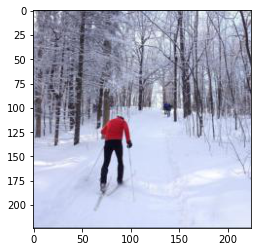

156.jpg


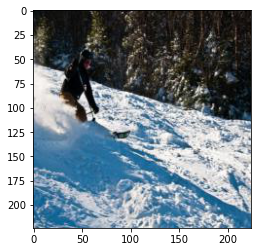

391.jpg


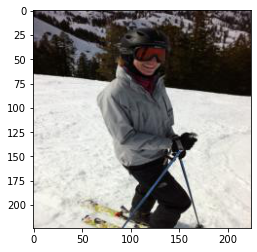

535.jpg


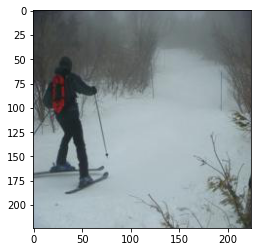

1940.jpg


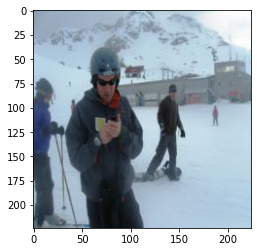

1311.jpg


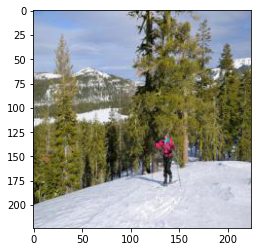

555.jpg


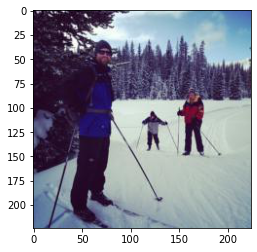

1096.jpg


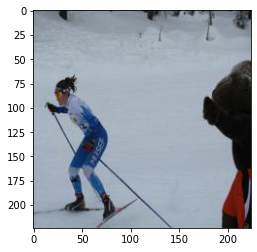

996.jpg
pizza sit top wooden cut board pizza load melt cheese vegetable green pepper pizza bell pepper meat sauce vegetable pizza slice piece pizza pizza cutter green pepper topping



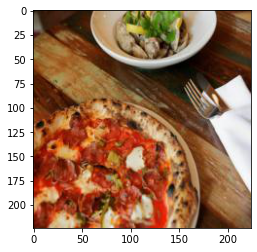

1999.jpg


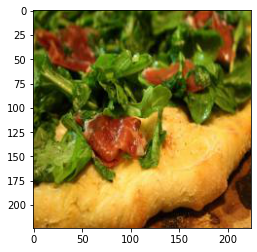

644.jpg


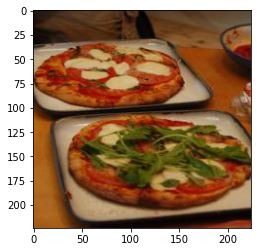

738.jpg


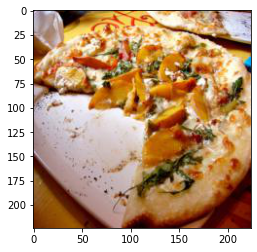

482.jpg


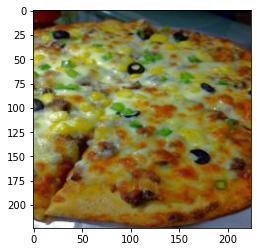

247.jpg


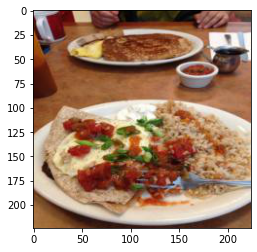

225.jpg


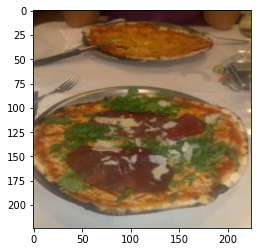

107.jpg


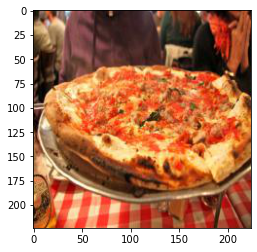

1369.jpg


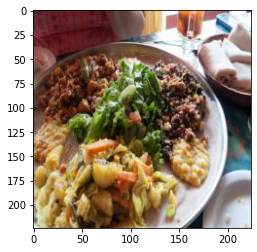

23.jpg


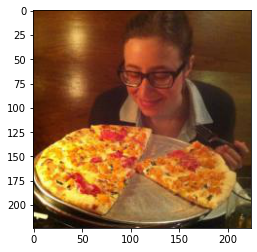

198.jpg


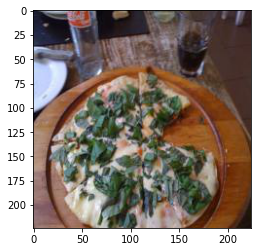

1615.jpg


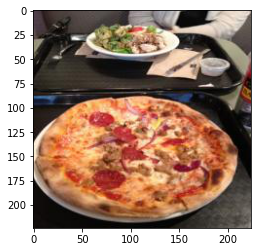

1839.jpg


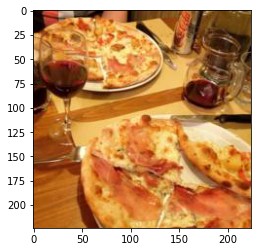

1184.jpg


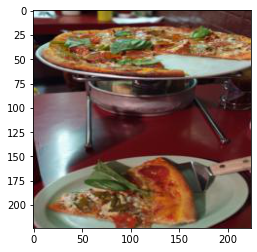

1959.jpg


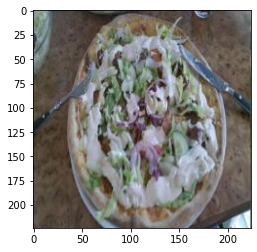

1114.jpg


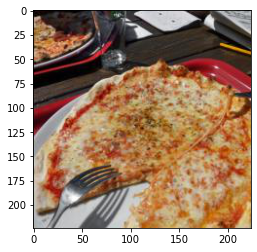

1141.jpg


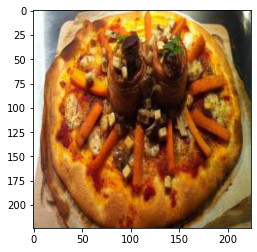

1334.jpg


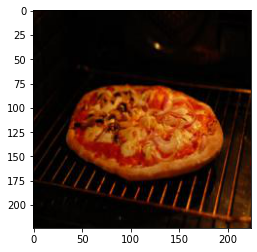

668.jpg


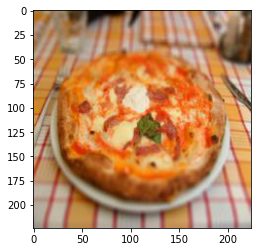

1102.jpg


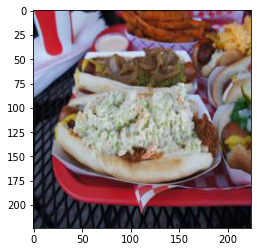

538.jpg
man hold yellow frisbee smile man hold frisbee field close building male tan shirt frisbee man hold frisbee read queer close person hold frisbee field



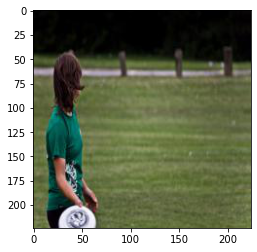

880.jpg


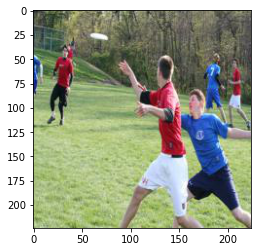

734.jpg


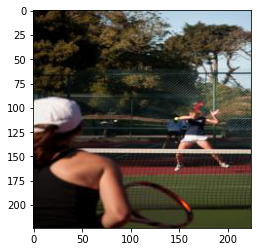

1551.jpg


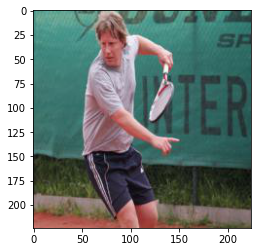

1676.jpg


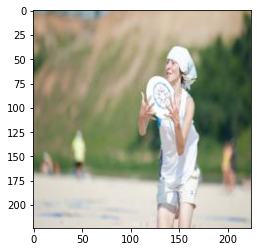

1385.jpg


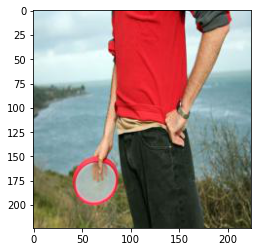

1127.jpg


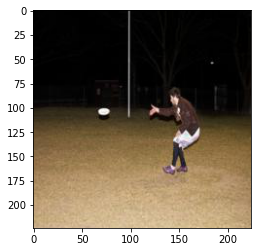

1433.jpg


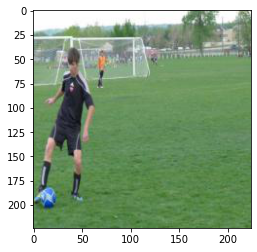

1434.jpg


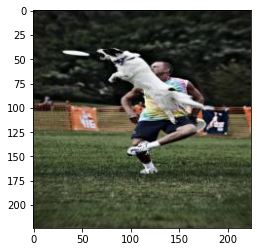

1926.jpg


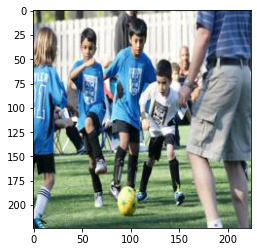

210.jpg


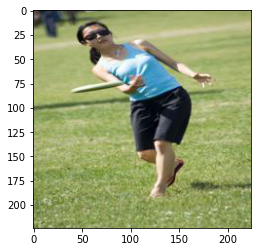

1746.jpg


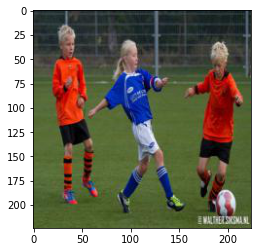

964.jpg


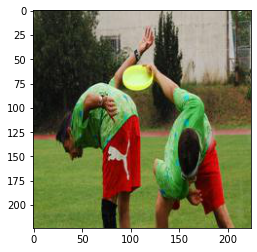

1236.jpg


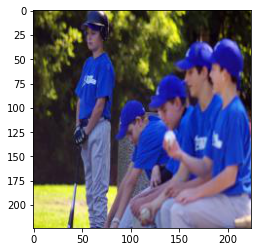

1972.jpg


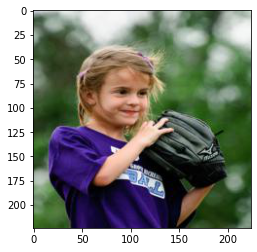

721.jpg


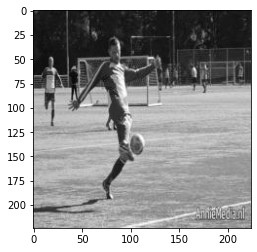

1591.jpg


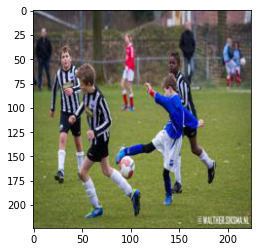

921.jpg


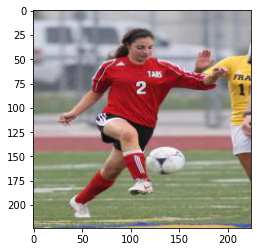

69.jpg


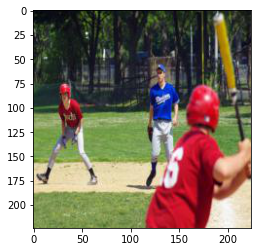

522.jpg


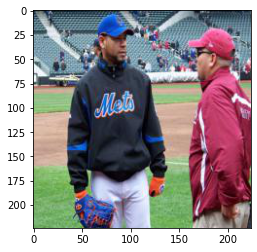

1721.jpg
man hold couple traffic light road man carry carry traffic light street man tan jacket carry traffic light man hold street light stand road man hold streetlight hand street



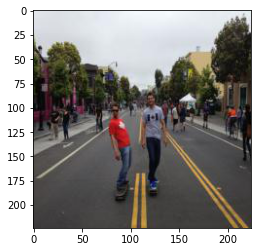

333.jpg


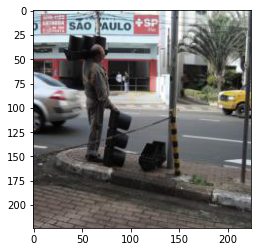

322.jpg


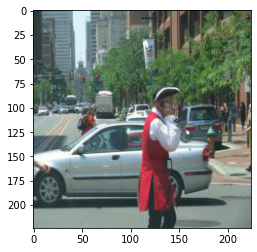

1883.jpg


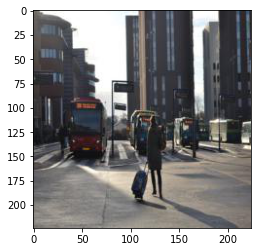

1144.jpg


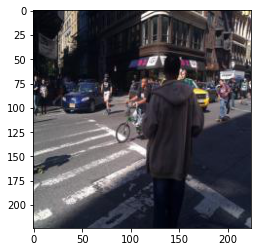

106.jpg


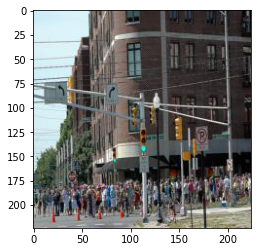

600.jpg


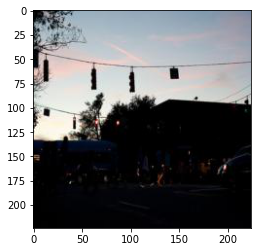

1183.jpg


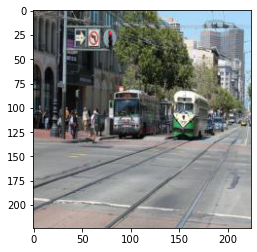

873.jpg


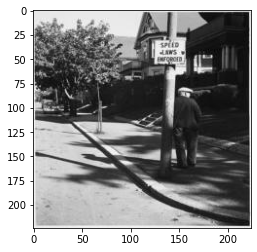

1499.jpg


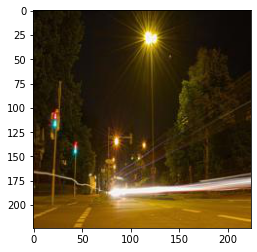

445.jpg


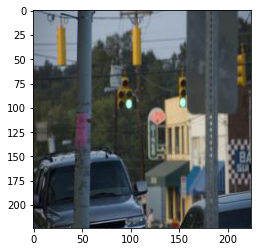

511.jpg


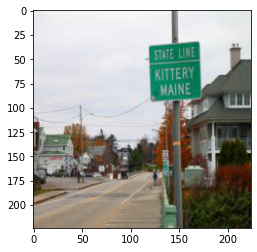

696.jpg


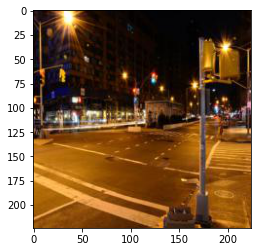

953.jpg


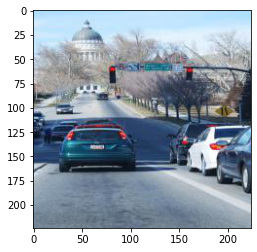

883.jpg


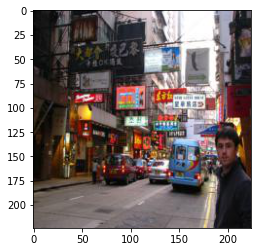

669.jpg


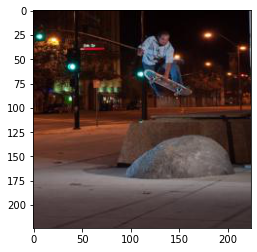

1533.jpg


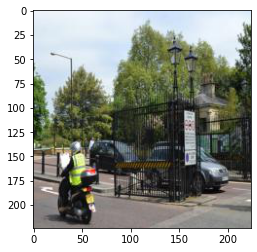

476.jpg


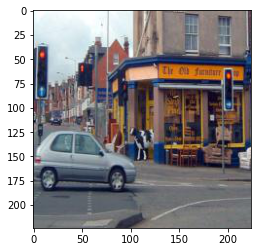

505.jpg


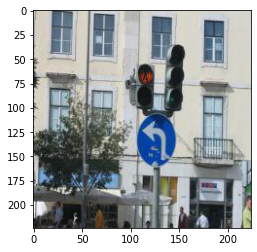

42.jpg


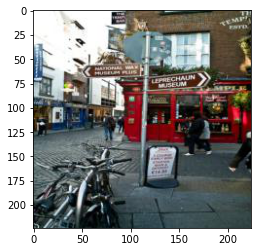

1413.jpg
couple rid top elephant forest people canopy rid elephant forest group people rid elephant forest elephant people rid people rid elephant shady trail



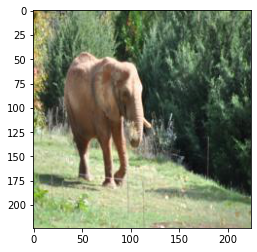

1279.jpg


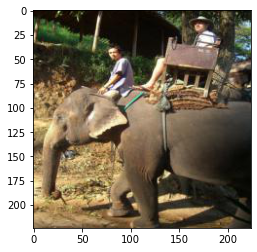

1463.jpg


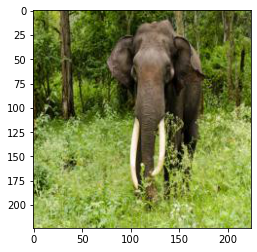

779.jpg


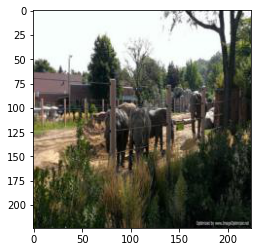

764.jpg


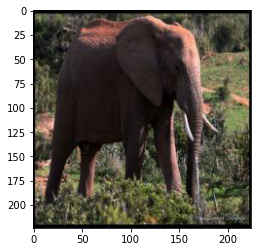

1450.jpg


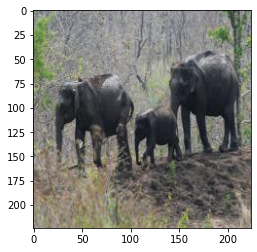

239.jpg


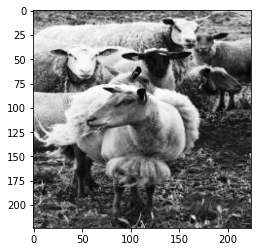

1329.jpg


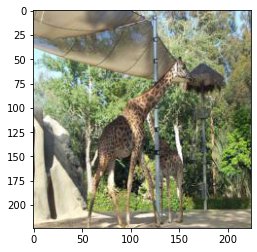

577.jpg


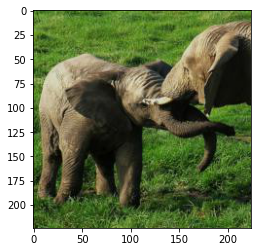

59.jpg


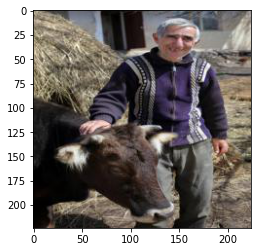

1140.jpg


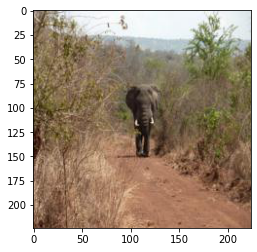

1528.jpg


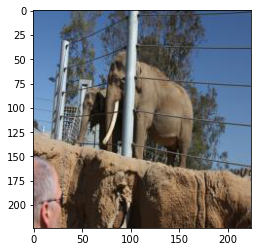

650.jpg


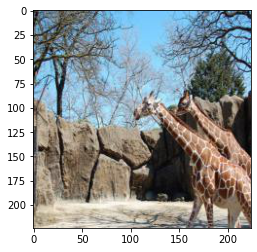

10.jpg


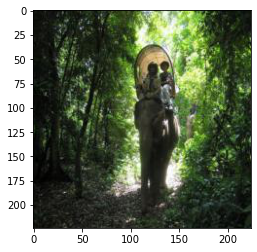

605.jpg


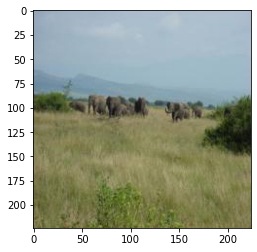

807.jpg


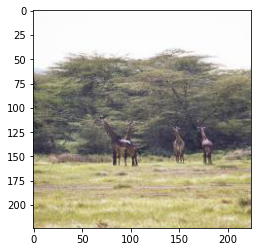

384.jpg


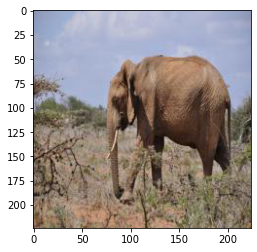

677.jpg


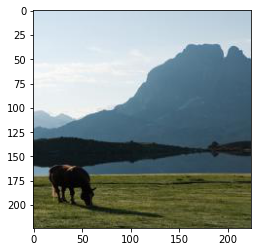

417.jpg


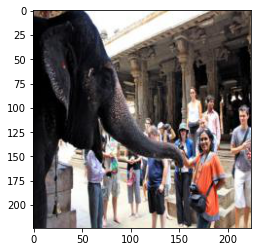

1819.jpg


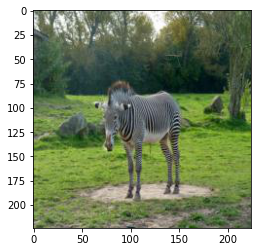

409.jpg
surfer surfer prepare stand surfboard man rid wave surfboard ocean man attempt stand surfboard man rid tiny wave man surfboard come shore



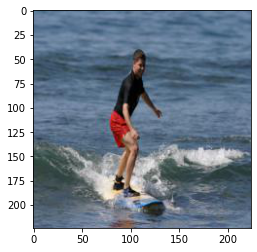

1189.jpg


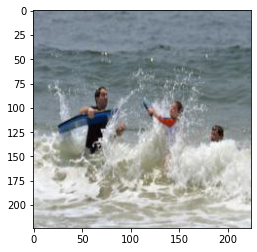

1301.jpg


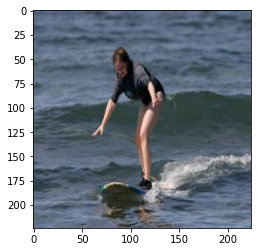

1552.jpg


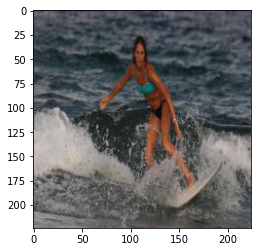

145.jpg


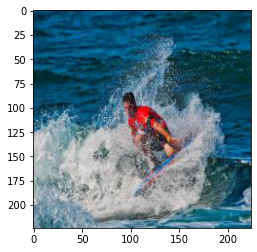

1357.jpg


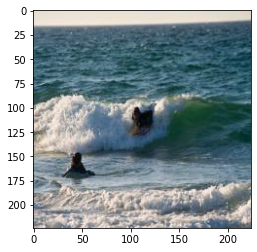

884.jpg


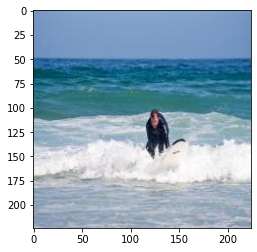

824.jpg


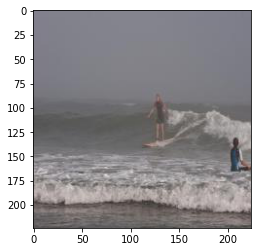

207.jpg


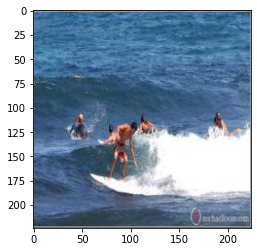

1128.jpg


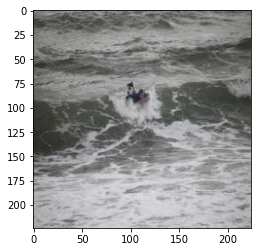

1370.jpg


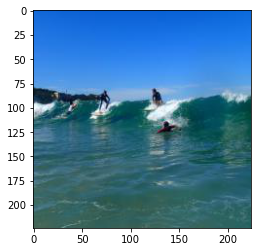

1358.jpg


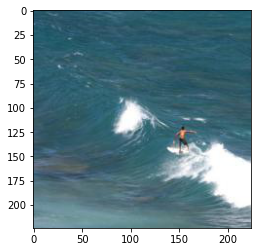

1063.jpg


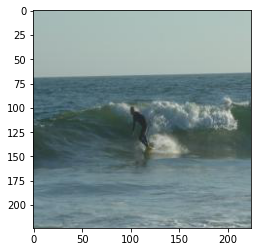

817.jpg


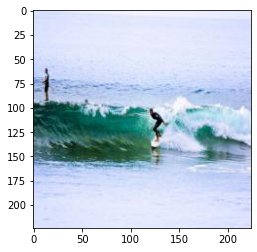

441.jpg


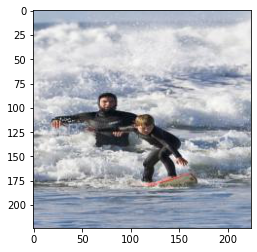

933.jpg


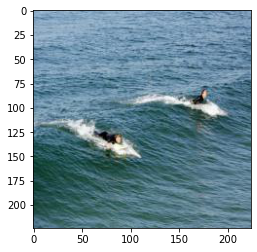

122.jpg


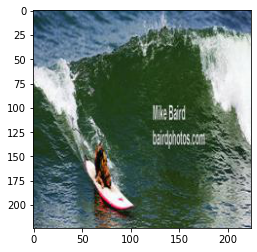

737.jpg


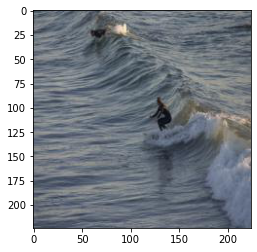

1731.jpg


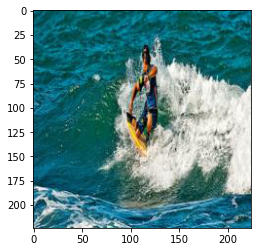

212.jpg


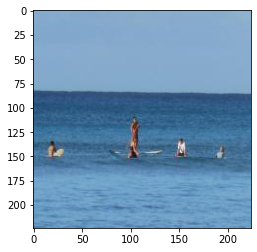

573.jpg


In [66]:
for row in range(10,20):
    desc = get_description(int(submit_sample['Description_ID'][row][:-4]),train_set=False)
    print(desc+'\n')
    row_imgs_lst = submit_sample['Top_20_Image_IDs'][row].split()
    for img_jpg in row_imgs_lst:
        img_num = int(img_jpg[:-4])
        show_image(img_num,train_set=False)
        print(img_jpg)

In [67]:
# Write to file
df_submit.to_csv("my_submission.csv", index=False)

# Further Directions

Here are some (unvetted) ideas to try:

* **Incorporate additional features:** Think about how you can incorporate the tag data. `word2vec` or similar models can be useful for this task.
* **Improve the baseline:**
    * Can we do better than random projection for the ResNet features? Do you know any other dimensionality reduction techniques that might help? (*cough* e.g. PCA *cough*)
    * Can we do better than a Ridge model? Maybe another type of regularized linear model? Maybe a non-linear model?
    * Is the euclidian distance the best distance metric to use? 
* **Think outside the box:** literally. Incorporate other language/vision models that exist out there. Get creative about the kind of additional data you can use, etc.

Finally, if all fails:

<img src="https://imgs.xkcd.com/comics/machine_learning_2x.png" width="500"/>
